<a href="https://colab.research.google.com/github/Fedelberg/python_project/blob/main/financial_literacy.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## **Project Overview**
The Financial Vulnerability Assessment Tool is a machine learning-based project designed to predict an individual's financial vulnerability based on their income, debt, savings, and other financial factors. The tool aims to provide personalized insights and recommendations to help individuals manage their finances effectively.

## **Problem Statement**
Many individuals struggle with financial management, leading to financial vulnerability and stress. Traditional financial assessment methods often rely on manual calculations and generic advice, which may not be effective for everyone.

## **Objective**
The objective of this project is to develop a machine learning-based tool that can accurately predict financial vulnerability and provide personalized recommendations to individuals.

## **About the Data**
The dataset contains 20,000 records with 26 features, including demographic information, financial information, and savings data. The features include:

- Demographic Information: Age, Dependents, Occupation, City_Tier
- Financial Information: Income, Rent, Loan_Repayment, Insurance, Groceries, Transport, Eating_Out, Entertainment, Utilities, Healthcare, Education, Miscellaneous
- Savings Information: Desired_Savings_Percentage, Desired_Savings, Disposable_Income, Potential_Savings

## **Task**
The task is to develop a machine learning model that can predict financial vulnerability based on the provided features.

## **Deliverable**
The deliverable for this project is a functional Financial Vulnerability Assessment Tool that can:

1. Collect user input through a chatbot
2. Predict financial vulnerability using a machine learning model
3. Provide personalized insights and recommendations

Tools, Frameworks, and Libraries
The expected tools, frameworks, and libraries for this project are:

1. Machine Learning Framework: Scikit-learn, TensorFlow, or PyTorch
2. Programming Language: Python
3. Data Preprocessing: Pandas, NumPy
4. Data Visualization: Matplotlib, Seaborn
5. Chatbot Development: Natural Language Processing (NLP) libraries such as NLTK or spaCy
6. Model Evaluation: Metrics such as accuracy, precision, recall, and F1-score

By leveraging these tools and frameworks, we can develop an effective Financial Vulnerability Assessment Tool that provides valuable insights and recommendations to individuals.

In [ ]:
import pandas as pd
import numpy as np
import io
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.linear_model import LinearRegression
from sklearn import metrics
from sklearn.metrics import accuracy_score

In [ ]:
from google.colab import files
uploaded = files.upload()

Saving financial_literacy_data.xlsx to financial_literacy_data.xlsx


In [ ]:
financial_literacy_data= "financial_literacy_data.xlsx"

In [ ]:
# Read the Excel file into a pandas DataFrame
df = pd.read_excel(financial_literacy_data)

# Display the DataFrame
print(df.shape)
print(df.head())

(20000, 27)
          Income  Age  Dependents     Occupation City_Tier          Rent  \
0   44637.249636   49           0  Self_Employed    Tier_1  13391.174891   
1   26858.596592   34           2        Retired    Tier_2   5371.719318   
2   50367.605084   35           1        Student    Tier_3   7555.140763   
3  101455.600247   21           0  Self_Employed    Tier_3  15218.340037   
4   24875.283548   52           4   Professional    Tier_2   4975.056710   

   Loan_Repayment    Insurance     Groceries    Transport  ...  \
0        0.000000  2206.490129   6658.768341  2636.970696  ...   
1        0.000000   869.522617   2818.444460  1543.018778  ...   
2     4612.103386  2201.800050   6313.222081  3221.396403  ...   
3     6809.441427  4889.418087  14690.149363  7106.130005  ...   
4     3112.609398   635.907170   3034.329665  1276.155163  ...   

   Desired_Savings  Disposable_Income  Potential_Savings_Groceries  \
0      6200.537192       11265.627707                  1685.6962

**Basic inspection**

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20000 entries, 0 to 19999
Data columns (total 27 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Income                           20000 non-null  float64
 1   Age                              20000 non-null  int64  
 2   Dependents                       20000 non-null  int64  
 3   Occupation                       20000 non-null  object 
 4   City_Tier                        20000 non-null  object 
 5   Rent                             20000 non-null  float64
 6   Loan_Repayment                   20000 non-null  float64
 7   Insurance                        20000 non-null  float64
 8   Groceries                        20000 non-null  float64
 9   Transport                        20000 non-null  float64
 10  Eating_Out                       20000 non-null  float64
 11  Entertainment                    20000 non-null  float64
 12  Utilities         

In [ ]:
df.isnull().sum()

,0
Income,0
Age,0
Dependents,0
Occupation,0
City_Tier,0
Rent,0
Loan_Repayment,0
Insurance,0
Groceries,0
Transport,0


In [ ]:

df.describe()

,Income,Age,Dependents,Rent,Loan_Repayment,Insurance,Groceries,Transport,Eating_Out,Entertainment,...,Desired_Savings,Disposable_Income,Potential_Savings_Groceries,Potential_Savings_Transport,Potential_Savings_Eating_Out,Potential_Savings_Entertainment,Potential_Savings_Utilities,Potential_Savings_Healthcare,Potential_Savings_Education,Potential_Savings_Miscellaneous
count,2.000000e+04,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,...,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000
mean,4.158550e+04,41.031450,1.995950,9115.494629,2049.800292,1455.028761,5205.667493,2704.466685,1461.856982,1448.853658,...,4982.878416,10647.367257,912.197183,473.042650,254.963280,254.031058,436.332808,41.524964,62.417083,144.904987
std,4.001454e+04,13.578725,1.417616,9254.228188,4281.789941,1492.938435,5035.953689,2666.345648,1481.660811,1489.019270,...,7733.468188,11740.637289,1038.884968,537.222853,296.047943,299.973590,503.200658,53.152458,98.842656,169.160951
min,1.301187e+03,18.000000,0.000000,235.365692,0.000000,30.002012,154.078240,81.228584,39.437523,45.421469,...,0.000000,-5400.788673,16.575501,8.268076,3.797926,3.121610,6.200297,0.001238,0.000000,2.091973
25%,1.760488e+04,29.000000,1.000000,3649.422246,0.000000,580.204749,2165.426419,1124.578012,581.011801,581.632906,...,1224.932636,3774.894323,317.811000,161.913751,84.506870,84.562090,148.013618,11.037421,4.926210,47.637307
50%,3.018538e+04,41.000000,2.000000,6402.751824,0.000000,1017.124681,3741.091535,1933.845509,1029.109726,1020.198376,...,2155.356763,7224.890977,607.038735,307.045856,164.927660,164.740232,285.739582,25.202124,33.127987,93.090257
75%,5.176545e+04,53.000000,3.000000,11263.940492,2627.142320,1787.160895,6470.892718,3360.597508,1807.075251,1790.104082,...,6216.309609,13331.950716,1128.681837,588.419602,313.398240,310.927935,538.983703,52.353736,80.946145,178.257981
max,1.079728e+06,64.000000,4.000000,215945.674703,123080.682009,38734.932935,119816.898124,81861.503457,34406.100166,38667.368308,...,245504.485208,377060.218482,34894.644404,12273.258242,5573.036433,6222.200913,8081.799518,1394.531049,3647.244243,4637.951137


In [ ]:
df.duplicated().sum()

np.int64(0)

**Basic Inspection:** The dataset contains 20,000 rows and 27 columns. There are no missing values, which simplifies the data cleaning process. The descriptive statistics provide an overview of the central tendency, spread, and range of the numerical features.

**Data Preprocessing**

In [ ]:
# Since there are no missing values, let's proceed with encoding categorical variables
categorical_cols = ['Occupation', 'City_Tier']
encoder = OneHotEncoder(sparse_output=False)
encoded_data = encoder.fit_transform(df[categorical_cols])
encoded_df = pd.DataFrame(encoded_data, columns=encoder.get_feature_names_out())

In [ ]:
# Drop original categorical columns and concatenate encoded columns
df = df.drop(categorical_cols, axis=1)
df = pd.concat([df, encoded_df], axis=1)


In [ ]:
# Scale numerical features
numerical_cols = df.select_dtypes(include=['int64', 'float64']).columns
scaler = StandardScaler()
df[numerical_cols] = scaler.fit_transform(df[numerical_cols])


In [ ]:
# Verify the preprocessed data
print(df.head())
print(df.info())

     Income       Age  Dependents      Rent  Loan_Repayment  Insurance  \
0  0.076268  0.586855   -1.407998  0.462036       -0.478737   0.503356   
1 -0.368048 -0.517841    0.002857 -0.404558       -0.478737  -0.392194   
2  0.219478 -0.444195   -0.702570 -0.168614        0.598434   0.500215   
3  1.496246 -1.475245   -1.407998  0.659482        1.111629   2.300480   
4 -0.417614  0.807795    1.413712 -0.447422        0.248222  -0.548678   

   Groceries  Transport  Eating_Out  Entertainment  ...  \
0   0.288553  -0.025315    0.128200       0.058651  ...   
1  -0.474048  -0.435606   -0.548371      -0.267708  ...   
2   0.219935   0.193877    0.035068       0.184323  ...   
3   1.883401   1.650864    2.415183       0.946513  ...   
4  -0.431178  -0.535695   -0.519045      -0.529668  ...   

   Potential_Savings_Healthcare  Potential_Savings_Education  \
0                      0.492135                    -0.631495   
1                     -0.657027                    -0.061819   
2       

**Data Preprocessing:** Categorical variables ('Occupation', 'City_Tier') have been successfully one-hot encoded, and numerical features have been scaled. The preprocessed data is ready for modeling.

**EXPLORATORY DATA ANALYSIS**

/tmp/ipython-input-1384942694.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(8, 6))


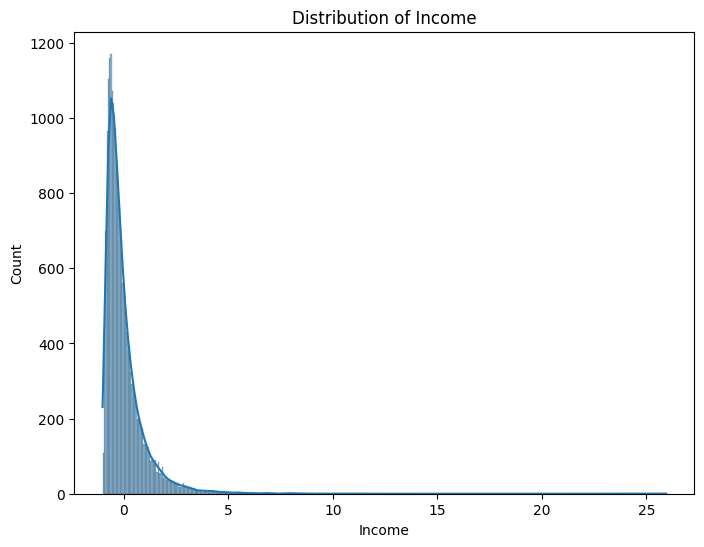

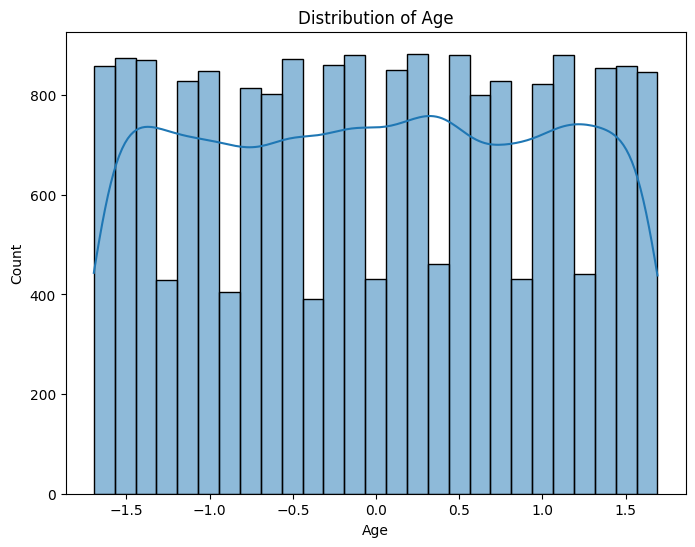

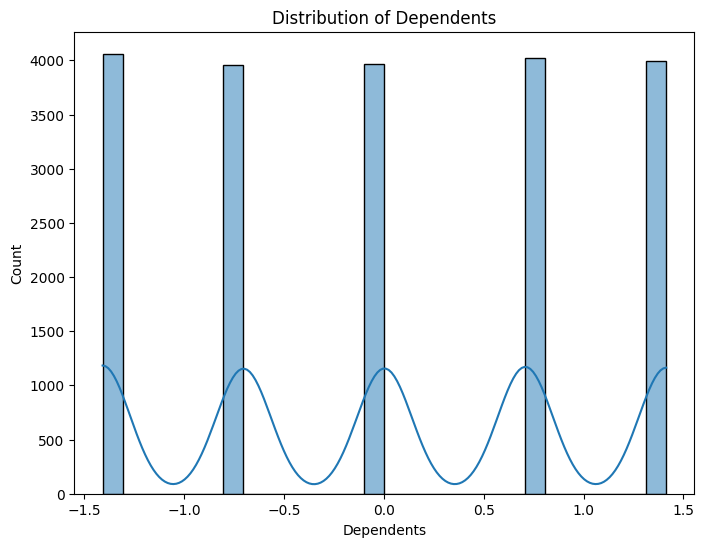

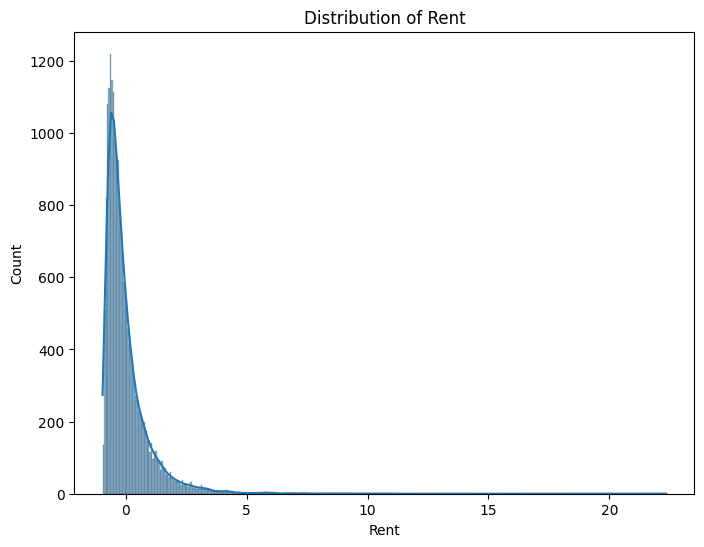

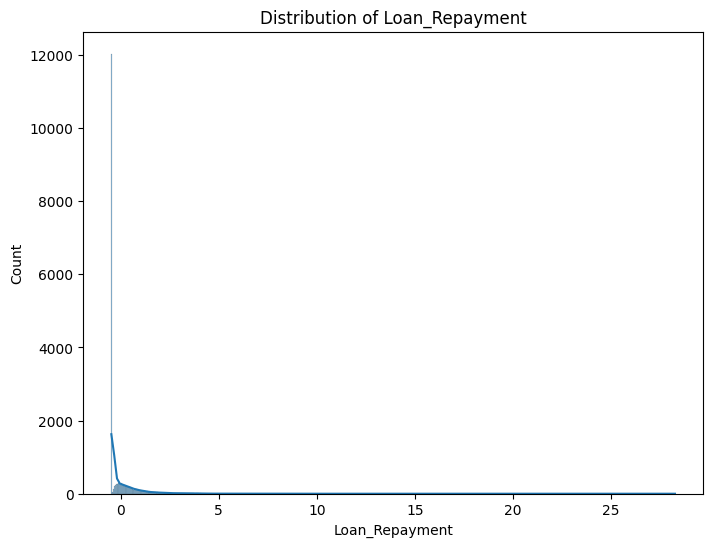

...

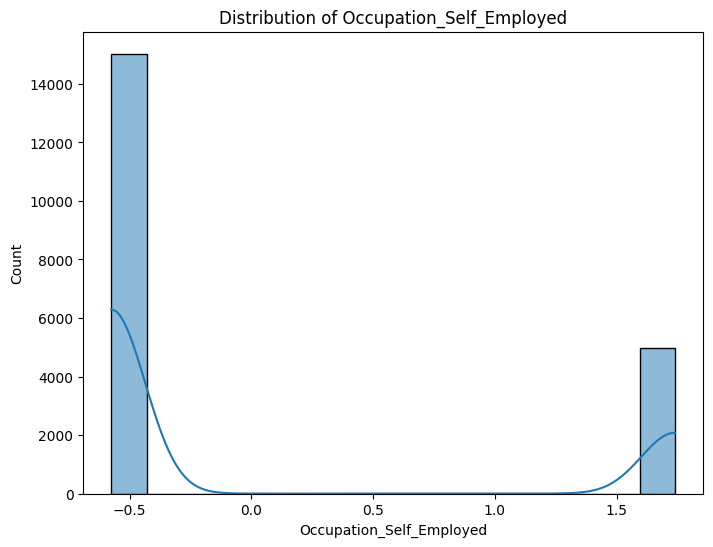

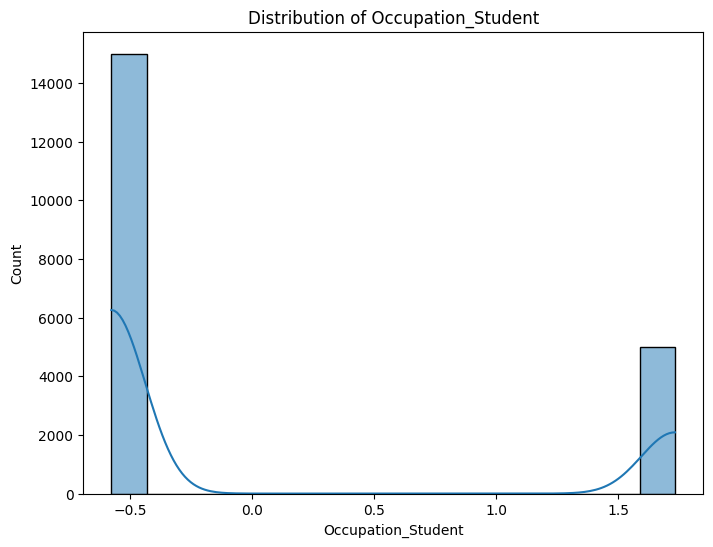

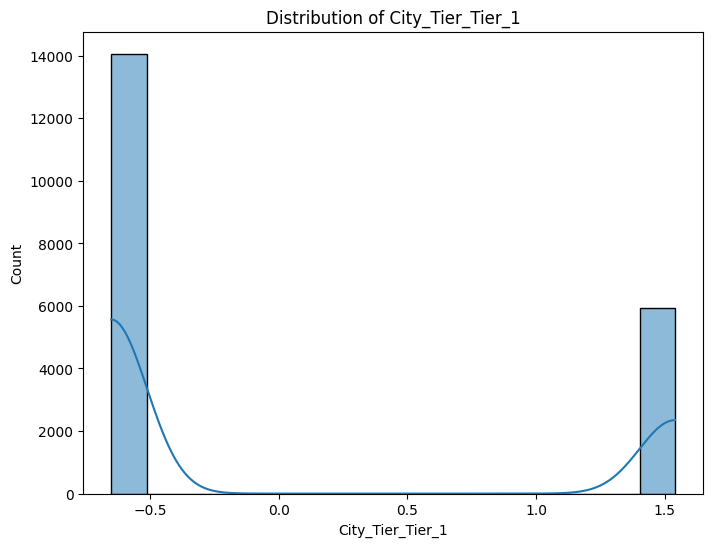

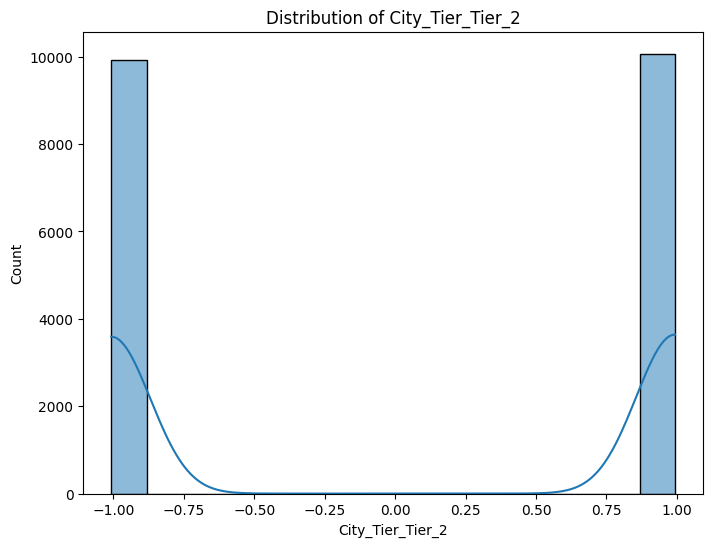

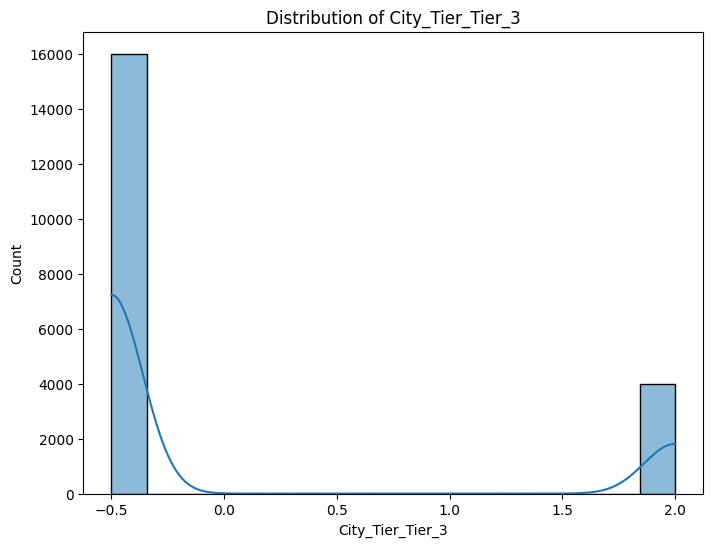

In [ ]:
# Plot histograms for numerical columns
numerical_cols = df.select_dtypes(include=['int64', 'float64']).columns
for col in numerical_cols:
    plt.figure(figsize=(8, 6))
    sns.histplot(df[col], kde=True)
    plt.title(f'Distribution of {col}')
plt.show();

 **Distribution Analysis:** Histograms revealed that some numerical variables, particularly 'Income', 'Loan_Repayment', and 'Desired_Savings', were skewed.

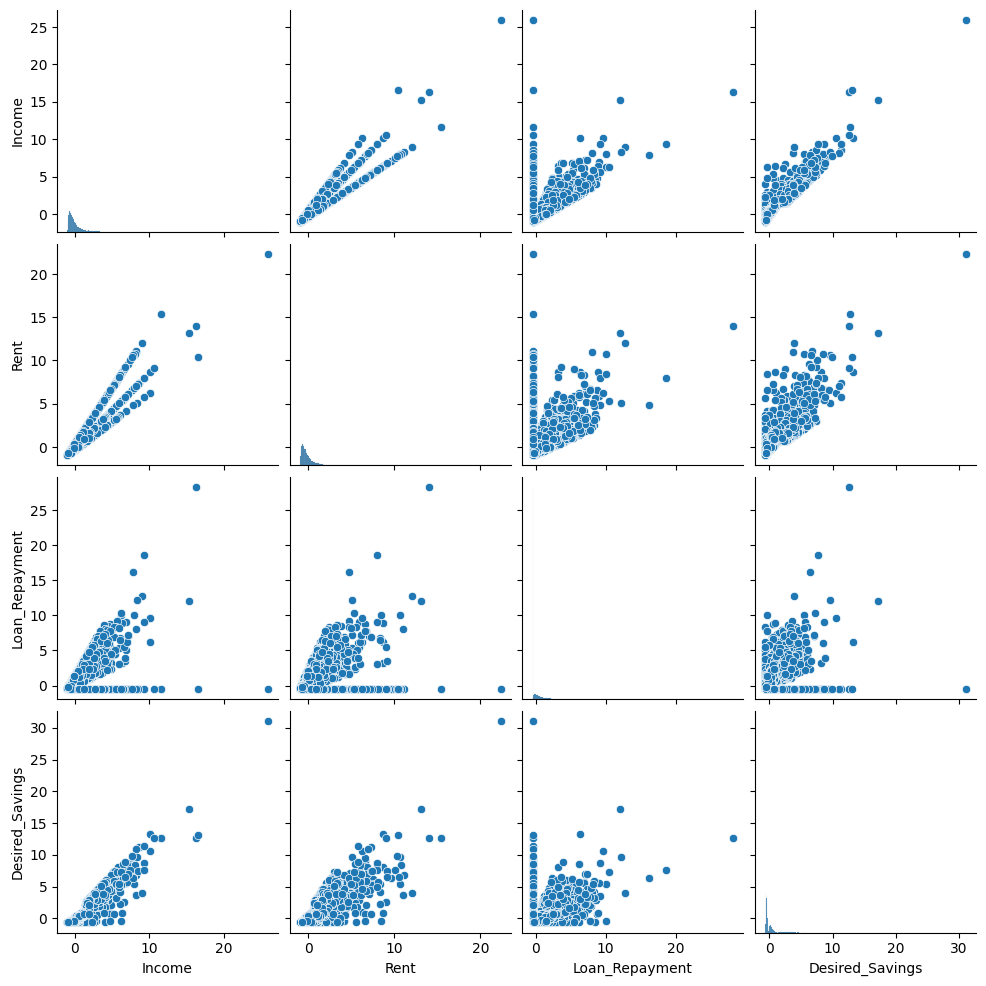

In [ ]:
# Plot scatter plots for relationships between variables
sns.pairplot(df[['Income', 'Rent', 'Loan_Repayment', 'Desired_Savings']])
plt.show()

**Relationship Analysis:** Pair plots and the correlation heatmap showed various degrees of linear relationships between the numerical variables. Several expense-related columns ('Rent', 'Insurance', 'Groceries', 'Transport', 'Eating_Out', 'Entertainment', 'Utilities', 'Healthcare', and 'Miscellaneous') are highly correlated with each other and with 'Income'. 'Desired_Savings' also shows a strong positive correlation with 'Income'.

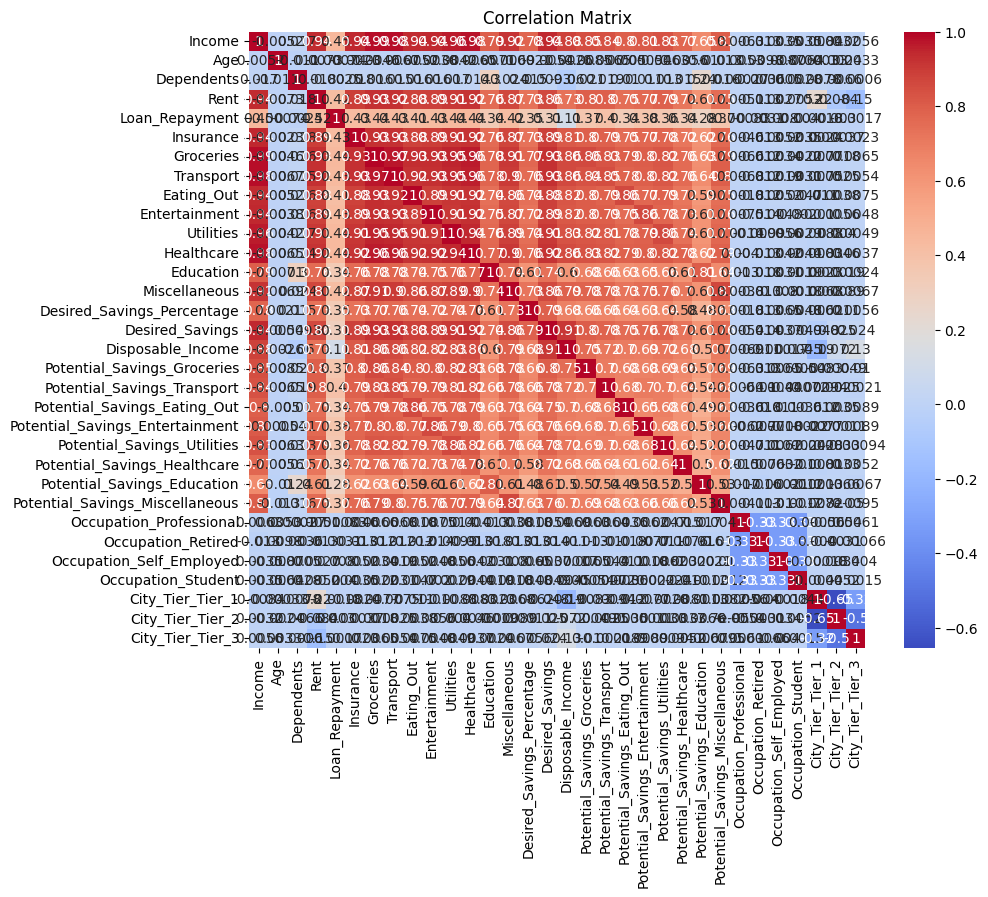

In [ ]:
# Calculate correlation matrix
corr_matrix = df.corr()

# Plot heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', square=True)
plt.title('Correlation Matrix')
plt.show()

In [ ]:
# Select skewed variables
skewed_vars = ['Income', 'Loan_Repayment', 'Desired_Savings']

# Apply log transformation
for var in skewed_vars:
    # Replace non-positive values with a small positive number to avoid log(0) or log(negative) issues
    df[var] = df[var].apply(lambda x: x if x > 0 else 1e-9)
    df[var] = np.log(df[var])

# Verify the transformation
for var in skewed_vars:
    print(f"Skewness of {var} after log transformation: {df[var].skew()}")

Skewness of Income after log transformation: 0.684557194187325
Skewness of Loan_Repayment after log transformation: 0.9506745102179468
Skewness of Desired_Savings after log transformation: 0.7843078596049586


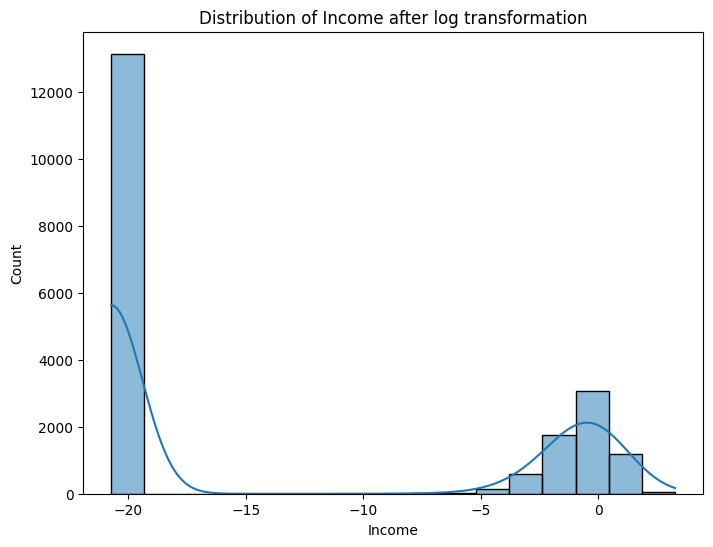

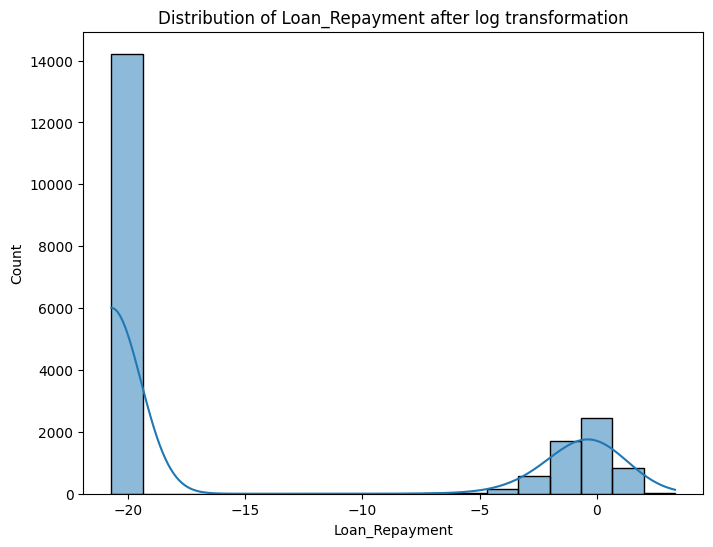

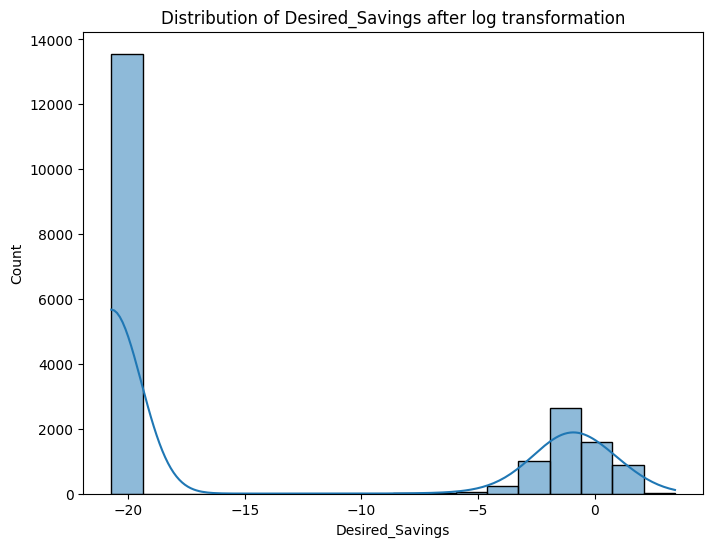

In [ ]:
for var in skewed_vars:
    plt.figure(figsize=(8, 6))
    sns.histplot(df[var], kde=True)
    plt.title(f'Distribution of {var} after log transformation')
plt.show()

**Transformation:** Applying log transformation to the skewed variables ('Income', 'Loan_Repayment', 'Desired_Savings') helped to reduce their skewness, making their distributions more symmetrical.

In [ ]:
# Compute the correlation matrix
corr_matrix = df.corr()

# Set a threshold for strong correlation (e.g., above 0.7 or below -0.7)
threshold = 0.7

# Create a mask to filter strong correlations
strong_corr = corr_matrix[(corr_matrix.abs() > threshold) & (corr_matrix.abs() < 1.0)]

# Drop rows and columns with all NaNs (no strong correlations)
strong_corr = strong_corr.dropna(how='all').dropna(axis=1, how='all')

# Display the result
print("Strongly correlated variable pairs:")
print(strong_corr)


Strongly correlated variable pairs:
                                   Income      Rent  Insurance  Groceries  \
Income                                NaN       NaN        NaN   0.717258   
Rent                                  NaN       NaN   0.894195   0.926205   
Insurance                             NaN  0.894195        NaN   0.928354   
Groceries                        0.717258  0.926205   0.928354        NaN   
Transport                        0.704585  0.922790   0.927134   0.967789   
Eating_Out                            NaN  0.878156   0.882410   0.929536   
Entertainment                         NaN  0.885604   0.890283   0.931417   
Utilities                             NaN  0.905489   0.909922   0.950489   
Healthcare                       0.710628  0.920814   0.921213   0.964956   
Education                             NaN  0.755500   0.757517   0.779126   
Miscellaneous                         NaN  0.867142   0.871969   0.905033   
Desired_Savings_Percentage       0.79579

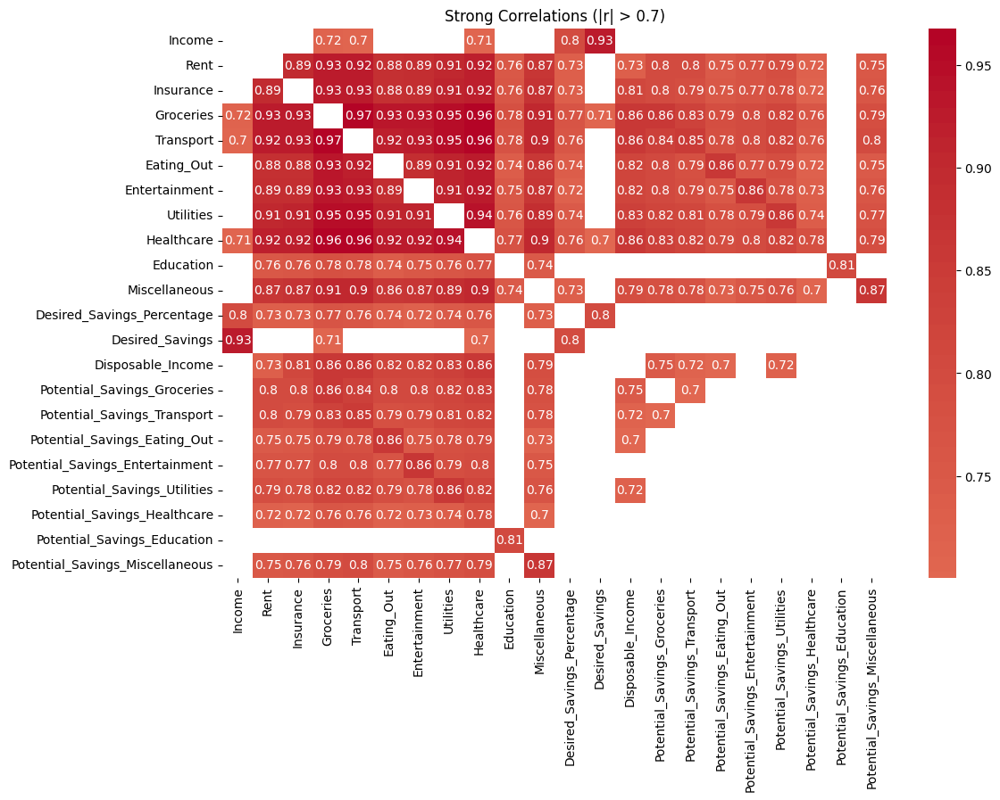

In [ ]:
plt.figure(figsize=(12, 8))
sns.heatmap(strong_corr, annot=True, cmap='coolwarm', center=0)
plt.title("Strong Correlations (|r| > 0.7)")
plt.show()


 **Strong Correlation Analysis:** The analysis of strong correlations (absolute correlation > 0.7) highlighted significant multicollinearity among the expense-related features and between 'Income' and 'Desired_Savings'. This suggests that some of these variables might be redundant or that techniques to handle multicollinearity (e.g., PCA, feature selection) might be considered for modeling.

In [ ]:
corr_matrix = df.corr()


In [ ]:
strong_corr = corr_matrix[(corr_matrix.abs() > 0.7) & (corr_matrix.abs() < 1.0)]


In [ ]:
strong_corr = strong_corr.dropna(how='all').dropna(axis=1, how='all')


<Axes: >

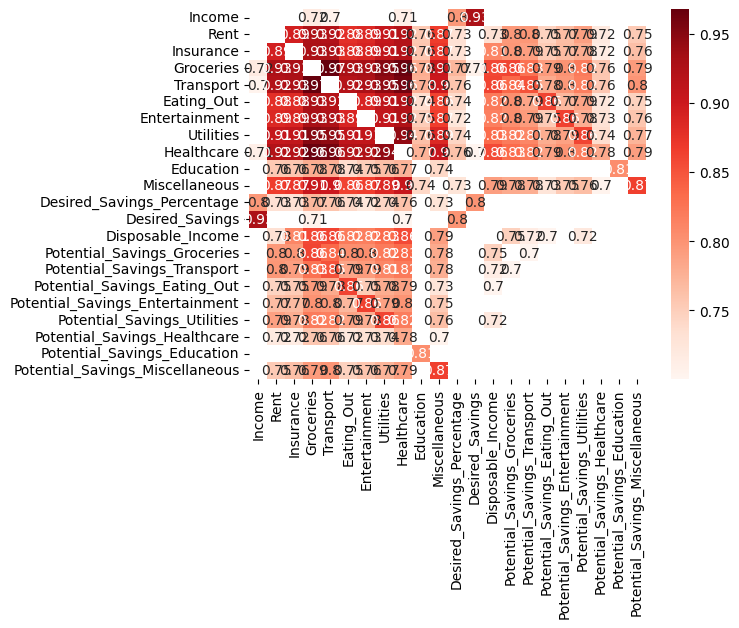

In [ ]:
sns.heatmap(strong_corr, annot=True, cmap='Reds')


## **FEATURE ENGINEERING**

In [ ]:
df['Savings_Rate'] = (df['Desired_Savings'] / df['Income'])*100

In [ ]:
df['Debt_to_Income'] = (df['Loan_Repayment'] / df['Income']) * 100

In [ ]:
df['Rent_to_Income'] = (df['Rent'] / df['Income']) * 100
df['Utilities_to_Income'] = (df['Utilities'] / df['Income']) * 100
df['Groceries_to_Income'] = (df['Groceries'] / df['Income']) * 100
df['Transport_to_Income'] = (df['Transport'] / df['Income']) * 100
df['Entertainment_to_Income'] = (df['Entertainment'] / df['Income'])*100

In [ ]:
df['Potential_Savings'] = df[['Potential_Savings_Groceries', 'Potential_Savings_Transport', 'Potential_Savings_Eating_Out', 'Potential_Savings_Entertainment', 'Potential_Savings_Utilities', 'Potential_Savings_Healthcare', 'Potential_Savings_Education', 'Potential_Savings_Miscellaneous']].sum(axis=1)
df['Potential_Savings_to_Income'] = (df['Potential_Savings'] / df['Income'])*100

In [ ]:
df['High_Debt'] = np.where(df['Debt_to_Income'] > 30, 1, 0)  # High debt (>30% of income)
df['Low_Savings'] = np.where(df['Savings_Rate'] < 10, 1, 0)  # Low savings (<10% of income)


- Creation of new features such as 'Savings_Rate', 'Debt_to_Income', 'Rent_to_Income', 'Utilities_to_Income', 'Groceries_to_Income', 'Transport_to_Income', 'Entertainment_to_Income', 'Potential_Savings', 'Potential_Savings_to_Income', 'High_Debt', and 'Low_Savings'. These new features were added to the DataFrame (`df`).

## **INTERACTIVE DASHBOARD**

In [ ]:
fig_income = px.histogram(df, x='Income', title='Income Distribution')
fig_income.update_layout(xaxis_title='Income', yaxis_title='Count')

In [ ]:
fig_savings_rate = px.histogram(df, x='Savings_Rate', title='Savings Rate Distribution')
fig_savings_rate.update_layout(xaxis_title='Savings Rate (%)', yaxis_title='Count')

In [ ]:
fig_debt_to_income = px.histogram(df, x='Debt_to_Income', title='Debt-to-Income Ratio Distribution')
fig_debt_to_income.update_layout(xaxis_title='Debt-to-Income Ratio (%)', yaxis_title='Count')

In [ ]:
expense_cols = ['Rent_to_Income', 'Utilities_to_Income', 'Groceries_to_Income', 'Transport_to_Income', 'Entertainment_to_Income']
fig_expense_ratios = px.box(x='variable', y='value', title='Expense Ratios', data_frame=df[expense_cols].melt())
fig_expense_ratios.update_layout(xaxis_title='Expense Category', yaxis_title='Expense Ratio (%)')

In [ ]:
fig_potential_savings = px.histogram(df, x='Potential_Savings_to_Income', title='Potential Savings Distribution')
fig_potential_savings.update_layout(xaxis_title='Potential Savings (%)', yaxis_title='Count')

In [ ]:
from plotly.subplots import make_subplots

fig_dashboard = make_subplots(rows=3, cols=2, subplot_titles=['Income Distribution', 'Savings Rate Distribution', 'Debt-to-Income Ratio Distribution', 'Expense Ratios', 'Potential Savings Distribution'])

fig_dashboard.add_trace(fig_income.data[0], row=1, col=1)
fig_dashboard.add_trace(fig_savings_rate.data[0], row=1, col=2)
fig_dashboard.add_trace(fig_debt_to_income.data[0], row=2, col=1)
fig_dashboard.add_trace(fig_expense_ratios.data[0], row=2, col=2)
fig_dashboard.add_trace(fig_potential_savings.data[0], row=3, col=1)

fig_dashboard.update_layout(height=1000, width=1000, title_text='Financial Dashboard')

In [ ]:
fig_dashboard.show()

- Generation of interactive visualizations (histograms and box plots) showing the distribution of key financial metrics and expense ratios ('Income', 'Savings_Rate', 'Debt_to_Income', 'Rent_to_Income', 'Utilities_to_Income', 'Groceries_to_Income', 'Transport_to_Income', 'Entertainment_to_Income', 'Potential_Savings_to_Income'). The output is a Plotly figure (`fig_dashboard`) displayed interactively.

In [ ]:
# Calculate Q1 and Q3 for each column
Q1 = df.quantile(0.25)
Q3 = df.quantile(0.75)

# Calculate IQR
IQR = Q3 - Q1

# Identify outliers
outliers = (df < (Q1 - 1.5 * IQR)) | (df > (Q3+1.5*IQR))

In [ ]:
df_cleaned = df[~outliers.any(axis=1)]

In [ ]:
from sklearn.impute import SimpleImputer

df_cleaned = df.copy()
for col in df.columns:
    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    # Identify outliers
    outliers_mask = (df_cleaned[col] < lower_bound) | (df_cleaned[col] > upper_bound)

    # Replace outliers with NaN temporarily for imputation
    df_cleaned.loc[outliers_mask, col] = np.nan

    # Use SimpleImputer to replace NaNs (outliers) with the median
    imputer = SimpleImputer(strategy='median')
    df_cleaned[col] = imputer.fit_transform(df_cleaned[[col]])

In [ ]:
fig_dashboard = make_subplots(rows=3, cols=2, subplot_titles=['Income Distribution', 'Savings Rate Distribution', 'Debt-to-Income Ratio Distribution', 'Expense Ratios', 'Potential Savings Distribution'])

fig_dashboard.add_trace(fig_income.data[0], row=1, col=1)
fig_dashboard.add_trace(fig_savings_rate.data[0], row=1, col=2)
fig_dashboard.add_trace(fig_debt_to_income.data[0], row=2, col=1)
fig_dashboard.add_trace(fig_expense_ratios.data[0], row=2, col=2)
fig_dashboard.add_trace(fig_potential_savings.data[0], row=3, col=1)


In [ ]:
df_cleaned = df.copy()
for col in df.columns:
    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    df_cleaned[col] = np.where(df[col] < lower_bound, df[col].median(), df[col])
    df_cleaned[col] = np.where(df[col] > upper_bound, df[col].median(),df[col])

**Outlier Treatment:**
- Identification and replacement of outliers in numerical features using the IQR method. Outliers were temporarily set to NaN and then imputed with the median value using `SimpleImputer`. The output is a cleaned DataFrame (`df_cleaned`) with outliers handled.

In [ ]:
#target variable
df_cleaned['Financial_Vulnerability'] = np.where((df_cleaned['Debt_to_Income'] > 30) | (df_cleaned['Savings_Rate']<10),1,0)

**Target Variable Creation:**
- Creation of the binary target variable 'Financial_Vulnerability' in the `df_cleaned` DataFrame, based on the 'Debt_to_Income' ratio and 'Savings_Rate'. The output is the `df_cleaned` DataFrame with the added 'Financial_Vulnerability' column.

In [ ]:
#split data

X = df_cleaned.drop(['Financial_Vulnerability'], axis=1)
y = df_cleaned['Financial_Vulnerability']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

**Data Splitting:**
- Division of the `df_cleaned` DataFrame into training and testing sets (`X_train`, `X_test`, `y_train`, `y_test`) for model training and evaluation. The output is four separate DataFrames/Series.

In [ ]:
#Train model
from sklearn.linear_model import LogisticRegression

model = LogisticRegression(max_iter=3000)
model.fit(X_train,y_train)

/usr/local/lib/python3.12/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. OF ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



LogisticRegression(max_iter=3000)

The logistic regression model has been trained successfully. Now you can evaluate its performance.

**Model Training:**
- Training of a Logistic Regression model (`model`) on the training data (`X_train`, `y_train`). The output is the trained `model` object.

In [ ]:
#Evaluate model
from sklearn.metrics import accuracy_score, classification_report

y_pred = model.predict(X_test)
print("Accuracy:", accuracy_score(y_test, y_pred))
print("Classification Report:")
print(classification_report(y_test,y_pred))

Accuracy: 0.99825
Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1076
           1       1.00      1.00      1.00      2924

    accuracy                           1.00      4000
   macro avg       1.00      1.00      1.00      4000
weighted avg       1.00      1.00      1.00      4000



**Model Evaluation:**
- Calculation and printing of evaluation metrics (Accuracy, Precision, Recall, F1-score) based on the model's predictions on the test set (`y_pred` compared to `y_test`). The output is the printed evaluation report.

In [ ]:
def chatbot():
    print("Welcome to the financial vulnerability assessment chatbot!")
    user_responses = {}

    # Collect essential information
    user_responses['Income'] = float(input("What is your income? "))
    user_responses['Loan_Repayment'] = float(input("What is your loan repayment amount? "))
    user_responses['Desired_Savings'] = float(input("What is your desired savings amount? "))
    user_responses['Age'] = int(input("What is your age? "))
    user_responses['Dependents'] = int(input("How many dependents do you have? "))

    # Collect categorical information
    occupation = input("What is your occupation? (Professional, Retired, Self_Employed, Student) ")
    city_tier = input("What is your city tier? (Tier 1, Tier 2, or Tier 3) ")

    # --- Section for adding more questions ---
    print("\nNow, let's gather a bit more information:")

    additional_questions = [
        "What percentage of your income do you save?",
        "Do you have an emergency fund? (yes/no)",
        "What are your potential monthly savings from reducing expenses (e.g., groceries, transport, eating out, entertainment, utilities, healthcare, education, miscellaneous)? (Enter a single estimated amount)",
    ]

    for i, question in enumerate(additional_questions):
        response = input(f"Question {i+1}: {question} ")
        user_responses[f'additional_q_{i+1}'] = response # Store responses with a unique key

    # You can process these additional responses here if needed later
    # For now, they are just collected

    # --- End of section for adding more questions ---


    # Create a DataFrame with all the features the model expects
    # Initialize with median values for features not directly asked
    user_data = pd.DataFrame(X_train.median().to_dict(), index=[0])

    # Update with user's responses for features used in the model
    user_data['Income'] = user_responses['Income']
    user_data['Loan_Repayment'] = user_responses['Loan_Repayment']
    user_data['Desired_Savings'] = user_responses['Desired_Savings']
    user_data['Age'] = user_responses['Age']
    user_data['Dependents'] = user_responses['Dependents']


    # Apply the same transformations as the training data
    # Log transform skewed variables (handle non-positive values)
    skewed_vars = ['Income', 'Loan_Repayment', 'Desired_Savings']
    for var in skewed_vars:
      user_data[var] = user_data[var].apply(lambda x: x if x > 0 else 1e-9)
      user_data[var] = np.log(user_data[var])

    # One-hot encode Occupation (ensure all columns are present)
    occupation_cols = [col for col in X_train.columns if col.startswith('Occupation_')]
    for col in occupation_cols:
        user_data[col] = 0
    # Format occupation input to match column names
    formatted_occupation = f'Occupation_{occupation}'
    if formatted_occupation in user_data.columns:
        user_data[formatted_occupation] = 1
    else:
        print(f"Warning: Occupation '{occupation}' not recognized. Setting to median occupation.")


    # One-hot encode City_Tier (ensure all columns are present)
    city_tier_cols = [col for col in X_train.columns if col.startswith('City_Tier_')]
    for col in city_tier_cols:
        user_data[col] = 0
    # Format city tier input to match column names
    formatted_city_tier = f'City_Tier_{city_tier.replace(" ", "_")}' # Replace space with underscore
    if formatted_city_tier in user_data.columns:
        user_data[formatted_city_tier] = 1
    else:
        print(f"Warning: City Tier '{city_tier}' not recognized. Setting to median city tier.")


    # Recreate engineered features (using the same logic as in training)
    user_data['Savings_Rate'] = (user_data['Desired_Savings'] / user_data['Income']) * 100
    user_data['Debt_to_Income'] = (user_data['Loan_Repayment'] / user_data['Income']) * 100
    user_data['Rent_to_Income'] = (user_data['Rent'] / user_data['Income']) * 100
    user_data['Utilities_to_Income'] = (user_data['Utilities'] / user_data['Income']) * 100
    user_data['Groceries_to_Income'] = (user_data['Groceries'] / user_data['Income']) * 100
    user_data['Transport_to_Income'] = (user_data['Transport'] / user_data['Income']) * 100
    user_data['Entertainment_to_Income'] = (user_data['Entertainment'] / user_data['Income'])*100

    potential_savings_cols = ['Potential_Savings_Groceries', 'Potential_Savings_Transport', 'Potential_Savings_Eating_Out', 'Potential_Savings_Entertainment', 'Potential_Savings_Utilities', 'Potential_Savings_Healthcare', 'Potential_Savings_Education', 'Potential_Savings_Miscellaneous']
    user_data['Potential_Savings'] = user_data[potential_savings_cols].sum(axis=1)
    user_data['Potential_Savings_to_Income'] = (user_data['Potential_Savings'] / user_data['Income'])*100

    user_data['High_Debt'] = np.where(user_data['Debt_to_Income'] > 30, 1, 0)
    user_data['Low_Savings'] = np.where(user_data['Savings_Rate'] < 10, 1, 0)


    # Ensure columns are in the same order as X_train
    user_data = user_data[X_train.columns]


    # Predict financial vulnerability
    prediction = model.predict(user_data)

    if prediction[0] == 1:
        print("You may be financially vulnerable. Consider reducing debt and increasing savings. Learning about personal finance can also help you make informed decisions and improve your financial situation."
)
    else:
        print("You appear to be financially stable. Keep up the good work and continue learning about personal finance to maintain your stability!"
)

chatbot()

Welcome to the financial vulnerability assessment chatbot!
What is your income? 1000
What is your loan repayment amount? 400
What is your desired savings amount? 200
What is your age? 30
How many dependents do you have? 5
What is your occupation? (Professional, Retired, Self_Employed, Student) Professional
What is your city tier? (Tier 1, Tier 2, or Tier 3) Tier 1

Now, let's gather a bit more information:
Question 1: What percentage of your income do you save? 20
Question 2: Do you have an emergency fund? (yes/no) yes
Question 3: What are your potential monthly savings from reducing expenses (e.g., groceries, transport, eating out, entertainment, utilities, healthcare, education, miscellaneous)? (Enter a single estimated amount) 500
You may be financially vulnerable. Consider reducing debt and increasing savings. Learning about personal finance can also help you make informed decisions and improve your financial situation.


**Chatbot:**
- A functional chatbot that collects user input, preprocesses it, uses the trained model to predict financial vulnerability, and provides a basic assessment. The output is text printed to the console based on the prediction.

In [ ]:
# Get the model coefficients
coefficients = model.coef_[0]

# Get the feature names
feature_names = X_train.columns

# Create a DataFrame to display coefficients and feature names
coef_df = pd.DataFrame({'Feature': feature_names, 'Coefficient': coefficients})

# Sort by absolute coefficient value to see the most influential features
coef_df['Abs_Coefficient'] = abs(coef_df['Coefficient'])
coef_df = coef_df.sort_values(by='Abs_Coefficient', ascending=False).drop('Abs_Coefficient', axis=1)

# Display the coefficients
print("Model Coefficients (sorted by absolute value):")
print(coef_df)

Model Coefficients (sorted by absolute value):
                            Feature  Coefficient
41                        High_Debt    10.415626
16                Disposable_Income     2.517356
27         Occupation_Self_Employed    -0.694222
31                 City_Tier_Tier_3    -0.603682
19     Potential_Savings_Eating_Out    -0.409197
14       Desired_Savings_Percentage     0.358512
2                        Dependents    -0.338766
24  Potential_Savings_Miscellaneous    -0.326391
29                 City_Tier_Tier_1    -0.308337
15                  Desired_Savings    -0.305274
10                        Utilities     0.289835
6                         Groceries     0.263253
20  Potential_Savings_Entertainment    -0.241740
12                        Education     0.228670
39                Potential_Savings    -0.211151
0                            Income     0.206794
5                         Insurance     0.190630
13                    Miscellaneous     0.170490
23      Potential_Savi

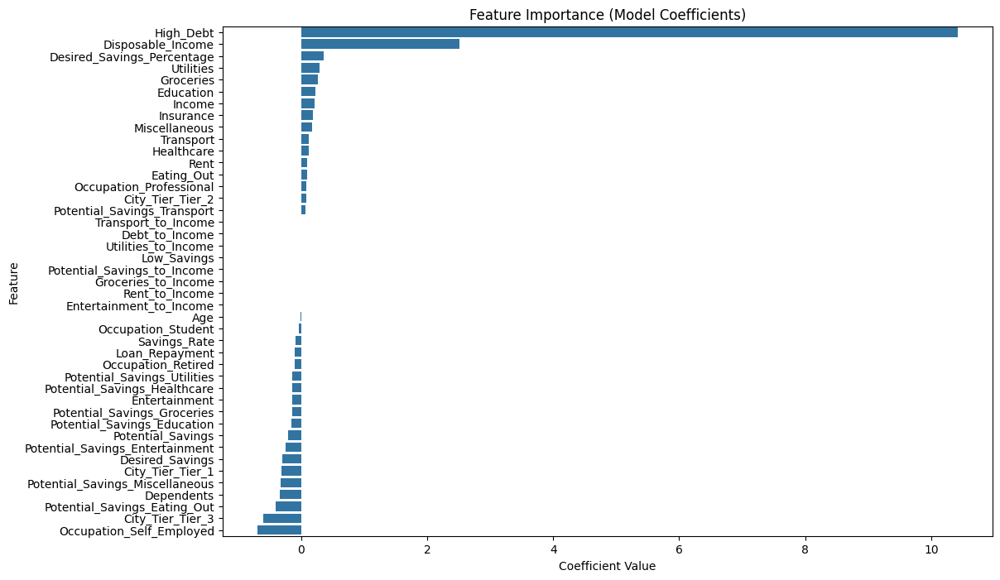

In [ ]:
# Sort the coefficients by absolute value for plotting
coef_df_plot = coef_df.sort_values(by='Coefficient', ascending=False)

plt.figure(figsize=(12, 8))
sns.barplot(x='Coefficient', y='Feature', data=coef_df_plot)
plt.title('Feature Importance (Model Coefficients)')
plt.xlabel('Coefficient Value')
plt.ylabel('Feature')
plt.show()

**Feature Importance Analysis:**
- Calculation and display of the model coefficients, sorted by absolute value (`coef_df`), to understand the importance of each feature in the prediction.
- Visualization of the model coefficients as a bar plot (`coef_df_plot`) for a visual representation of feature importance. The output is the printed DataFrame of coefficients and the displayed bar plot.